<a href="https://colab.research.google.com/github/adlerabf/Data_Science_Course_Projects/blob/main/Meu_Projeto_Panorama_do_COVID_19_no_Brasil.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<img alt="Colaboratory logo" width="15%" src="https://raw.githubusercontent.com/carlosfab/escola-data-science/master/img/novo_logo_bg_claro.png">

#### **Data Science na Prática 3.0**
*by [sigmoidal.ai](https://sigmoidal.ai)*  

---
  

# Panorama do COVID-19 no Brasil

COVID-19 é uma doença infecciosa causada por recém-descoberto coronavírus.

Transmitido principalmente por meio de gotículas provenientes de tosses ou espirros de pessoas infectadas, a gravidade dos sintomas varia muito de pessoa para pessoa.

Fato é, não se sabe muita coisa a respeito do COVID-19. Estudos estão sendo realizados no mundo todo, porém os resultados ainda não são conclusivos e definitivos.

<center><img alt="Colaboratory logo" width="50%" src="https://raw.githubusercontent.com/carlosfab/dsnp2/master/img/covid19.jpg"></center>

Até o presente momento, observa-se que cerca de 80% dos casos confirmados são assintomáticos e rápidos. A maioria das pessoas que se encaixam nesse grupo, se recupera sem nenhuma sequela.

No entanto, 15% das pessoas terão infecções graves e precisarão de oxigênio. O restante das pessoas, que representam 5%, serão classificadas como infecções muito graves e precisarão de ventilação assistida, por meio de respiradores mecânicos em ambiente hospitalar.

Com o objetivo de elevar a consciência situacional a respeito do COVID-19 no Brasil, irei realizar uma análise sobre os dados públicos da doença.

## Obtenção dos Dados

A origem desses dados vem de um repositório criado no GitHub pela [Our World in Data](https://github.com/owid/covid-19-data/tree/master/public/data). Seu portal oficial pode ser acessado [neste link](https://ourworldindata.org/about). Trata-se de um grupo de pesquisadores que tem como objetivo colher dados do mundo todo a respeito de diversos temas sociais, sendo um deles, doenças como COVID-19.  

A obtenção desses dados pode ser distorcida para alguns países devido a dificuldade de coleta dos mesmos pela Our World in Data ou devido alguns países não divulgarem com exatidão seus resultado. Contudo conseguimos ter uma noção através dessa base de dados, do impacto no COVID no Brasil e no Mundo como um todo, sendo esse o objetivo das comparações neste projeto.

### Dicionário das pricipais Variáveis Usadas no Projeto

* total_cases - total de casos confirmados e possíves casos de covid
* total_deaths - total de mortes confirmadas e possíveis mortes por covid
* gdp_per_capita - PIB dos países
* lethality - total de mortes confirmadas divido pelo total de casos (variável criada por mim para este projeto)

In [ ]:
# Instalando Bar Chart Race e importando sua biblioteca
!pip install bar_chart_race -q
import bar_chart_race as bcr

     |████████████████████████████████| 156 kB 7.6 MB/s 


In [ ]:
# importar as bibliotecas necessárias
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
# importar o dataset COVID-19 para um DataFrame

df = pd.read_csv('https://covid.ourworldindata.org/data/owid-covid-data.csv')
df.head()

,iso_code,continent,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,...,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,population,excess_mortality_cumulative_absolute,excess_mortality_cumulative,excess_mortality,excess_mortality_cumulative_per_million
0,AFG,Asia,Afghanistan,2020-02-24,5.0,5.0,NaN,NaN,NaN,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
1,AFG,Asia,Afghanistan,2020-02-25,5.0,0.0,NaN,NaN,NaN,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
2,AFG,Asia,Afghanistan,2020-02-26,5.0,0.0,NaN,NaN,NaN,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
3,AFG,Asia,Afghanistan,2020-02-27,5.0,0.0,NaN,NaN,NaN,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
4,AFG,Asia,Afghanistan,2020-02-28,5.0,0.0,NaN,NaN,NaN,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN


## Análise Exploratória dos Dados

In [ ]:
# Transformar a variável date em datetime (formato de data)
df.date = pd.to_datetime(df.date)

In [ ]:
# Transformando a coluna date no indice do meu dataframe
df.set_index(df.date, inplace=True)
df.head()

,iso_code,continent,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,...,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,population,excess_mortality_cumulative_absolute,excess_mortality_cumulative,excess_mortality,excess_mortality_cumulative_per_million
date,,,,,,,,,,,,,,,,,,,,,
2020-02-24,AFG,Asia,Afghanistan,2020-02-24,5.0,5.0,NaN,NaN,NaN,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
2020-02-25,AFG,Asia,Afghanistan,2020-02-25,5.0,0.0,NaN,NaN,NaN,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
2020-02-26,AFG,Asia,Afghanistan,2020-02-26,5.0,0.0,NaN,NaN,NaN,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
2020-02-27,AFG,Asia,Afghanistan,2020-02-27,5.0,0.0,NaN,NaN,NaN,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
2020-02-28,AFG,Asia,Afghanistan,2020-02-28,5.0,0.0,NaN,NaN,NaN,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN


In [ ]:
# Printando as linhas e colunas do dataframe
print('Linhas:', df.shape[0])
print('Colunas:', df.shape[1])

Linhas: 236617
Colunas: 67


## Analise Países do G20

O G-20 é um fórum informal que promove debate aberto e construtivo entre países industrializados e emergentes sobre assuntos-chave relacionados à estabilidade econômica global. O G-20 apoia o crescimento e o desenvolvimento mundial por meio do fortalecimento da arquitetura financeira internacional e via oportunidades de diálogo sobre políticas nacionais, cooperação internacional e instituições econômico-financeiras internacionais.

Criado em resposta às crises financeiras do final dos anos 90, o G-20 reflete mais adequadamente a diversidade de interesses das economias industrializadas e emergentes, possuindo assim maior representatividade e legitimidade. O Grupo conta com a participação de Chefes de Estado, Ministros de Finanças e Presidentes de Bancos Centrais de 19 países: **África do Sul, Alemanha, Arábia Saudita, Argentina, Austrália, Brasil, Canadá, China, Coreia do Sul, Estados Unidos, França, Índia, Indonésia, Itália, Japão, México, Reino Unido, Rússia e Turquia**. A União Europeia também faz parte do Grupo, representada pela presidência rotativa do Conselho da União Europeia e pelo Banco Central Europeu. Ainda, para garantir o trabalho simultâneo com instituições internacionais, o Diretor-Gerente do Fundo Monetário Internacional (FMI) e o Presidente do Banco Mundial também participam das reuniões. Desde o advento da última crise, o G-20 passou também a trabalhar em iniciativas diversas com outros organismos, países convidados e fóruns internacionais, como o BIS, FSB, OCDE, dentre outros. Ainda, a ocasião trouxe a separação da pauta do G-20 em duas trilhas: financeira, a cargo dos ministérios das finanças e bancos centrais dos países-membros; e de desenvolvimento, sob a responsabilidade dos ministérios de relações exteriores. *Fonte:* [BCB](https://www.bcb.gov.br/rex/g20/port/mencaog20.asp?frame=1#:~:text=O%20Grupo%20conta%20com%20a,Reino%20Unido%2C%20R%C3%BAssia%20e%20Turquia.)

In [ ]:
# Filtrando países do G20
dfG20 = df[df['location'].isin(['Australia', 
                                'Canada', 
                                'Saudi Arabia', 
                                'United States', 
                                'India', 
                                'Russia', 
                                'South Africa',
                                'Turkey', 
                                'Argentina',
                                'Brazil', 
                                'Mexico', 
                                'France', 
                                'Germany', 
                                'Italy', 
                                'United Kingdom', 
                                'China', 
                                'Indonesia', 
                                'Japan', 
                                'South Korea'])]                                

In [ ]:
# Verificando todas as variáveis do dataframe do G20
dfG20.columns

Index(['iso_code', 'continent', 'location', 'date', 'total_cases', 'new_cases',
       'new_cases_smoothed', 'total_deaths', 'new_deaths',
       'new_deaths_smoothed', 'total_cases_per_million',
       'new_cases_per_million', 'new_cases_smoothed_per_million',
       'total_deaths_per_million', 'new_deaths_per_million',
       'new_deaths_smoothed_per_million', 'reproduction_rate', 'icu_patients',
       'icu_patients_per_million', 'hosp_patients',
       'hosp_patients_per_million', 'weekly_icu_admissions',
       'weekly_icu_admissions_per_million', 'weekly_hosp_admissions',
       'weekly_hosp_admissions_per_million', 'total_tests', 'new_tests',
       'total_tests_per_thousand', 'new_tests_per_thousand',
       'new_tests_smoothed', 'new_tests_smoothed_per_thousand',
       'positive_rate', 'tests_per_case', 'tests_units', 'total_vaccinations',
       'people_vaccinated', 'people_fully_vaccinated', 'total_boosters',
       'new_vaccinations', 'new_vaccinations_smoothed',
       't

In [ ]:
# Analisando formato dos dados do novo dataframe do G20
print('Linhas:', dfG20.shape[0])
print('Colunas:', dfG20.shape[1])

Linhas: 19481
Colunas: 67


## Preparando dados para um Bar Chart Race

O Bar Chart Race tem sido muito utilizado nas redes sociais, para emostrar uma corrida de barras da evolução/crescimento de um certo conjunto de dados.

Para utilizalo, devemos preparar os dados no modelo aceitavel para que o código dele leia e crie o gráfico.

A documentação desde gráfico pode ser consultada [neste link](https://www.dexplo.org/bar_chart_race/).

In [ ]:
# Criando a coluna day para filtrar as linhas por dia
df_bcr = dfG20
df_bcr['day'] = dfG20.index.day

In [ ]:
# Visualizando as colunas do novo dataset para verificar a inclusão da coluna day
df_bcr.columns

Index(['iso_code', 'continent', 'location', 'date', 'total_cases', 'new_cases',
       'new_cases_smoothed', 'total_deaths', 'new_deaths',
       'new_deaths_smoothed', 'total_cases_per_million',
       'new_cases_per_million', 'new_cases_smoothed_per_million',
       'total_deaths_per_million', 'new_deaths_per_million',
       'new_deaths_smoothed_per_million', 'reproduction_rate', 'icu_patients',
       'icu_patients_per_million', 'hosp_patients',
       'hosp_patients_per_million', 'weekly_icu_admissions',
       'weekly_icu_admissions_per_million', 'weekly_hosp_admissions',
       'weekly_hosp_admissions_per_million', 'total_tests', 'new_tests',
       'total_tests_per_thousand', 'new_tests_per_thousand',
       'new_tests_smoothed', 'new_tests_smoothed_per_thousand',
       'positive_rate', 'tests_per_case', 'tests_units', 'total_vaccinations',
       'people_vaccinated', 'people_fully_vaccinated', 'total_boosters',
       'new_vaccinations', 'new_vaccinations_smoothed',
       't

In [ ]:
# Criando uma variável filtrando os dias do dataframe para contar de 10 em 10 dias (reduzindo o tamanho do Dataframe)
df_bcr = df_bcr[df_bcr['day'].isin([1, 10, 20, 30])]

In [ ]:
# Visualizando o novo formato do dataframe
print('Linhas:',df_bcr.shape[0])
print('Colunas:',df_bcr.shape[1])

Linhas: 2509
Colunas: 69


In [ ]:
# Mudando a orientação do dataframe para um formato aceito pelo bar chart race do total de mortes
df_bcr_deaths = df_bcr.pivot(index='date', columns='location', values='total_deaths')
# Visualizando as 5 primeiras entradas
df_bcr_deaths.head()

location,Argentina,Australia,Brazil,Canada,China,France,Germany,India,Indonesia,Italy,Japan,Mexico,Russia,Saudi Arabia,South Africa,South Korea,Turkey,United Kingdom,United States
date,,,,,,,,,,,,,,,,,,,
2020-01-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2020-01-10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2020-01-20,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2020-01-30,NaN,NaN,NaN,NaN,171.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN
2020-02-01,NaN,NaN,NaN,NaN,259.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN


In [ ]:
# Limpando as linhas que estiverem totalmente preenchidas por valores NaN (isso da erro no Bar Chart Race, precisa começar com algum dado)
df_bcr_deaths.dropna(axis='rows', how='all', inplace=True)
# Verificando novo formato do dataframe
print('Linhas',df_bcr_deaths.shape[0])
print('Colunas',df_bcr_deaths.shape[1])

Linhas 133
Colunas 19


In [ ]:
# Mudando a orientação do dataframe para um formato aceito pelo bar chart race do total de casos
df_bcr_cases = df_bcr.pivot(index='date', columns='location', values='total_cases')
df_bcr_cases.head()

location,Argentina,Australia,Brazil,Canada,China,France,Germany,India,Indonesia,Italy,Japan,Mexico,Russia,Saudi Arabia,South Africa,South Korea,Turkey,United Kingdom,United States
date,,,,,,,,,,,,,,,,,,,
2020-01-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2020-01-10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2020-01-20,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2020-01-30,NaN,9.0,NaN,4.0,8124.0,5.0,4.0,1.0,NaN,NaN,11.0,NaN,NaN,NaN,NaN,4.0,NaN,NaN,6.0
2020-02-01,NaN,12.0,NaN,4.0,11871.0,6.0,8.0,1.0,NaN,2.0,20.0,NaN,2.0,NaN,NaN,12.0,NaN,2.0,8.0


In [ ]:
# Limpando as linhas que estiverem totalmente preenchidas por valores NaN
df_bcr_cases.dropna(axis='rows', how='all', inplace=True)

print('Linhas',df_bcr_cases.shape[0])
print('Colunas',df_bcr_cases.shape[1])

Linhas 133
Colunas 19


### Bar Chart Race: Total de Casos

In [ ]:
# Plotando um Bar Chart Race do total de casos por país do G20
bcr.bar_chart_race(
    df=df_bcr_cases,
    filename=None, # nomeando o arquivo
    title='COVID-19: Total de Casos por País', # nomeando titulo
    perpendicular_bar_func='mean', # barra perpendicular informando a média 
    steps_per_period=30, # pulo de frames por período
    period_length=1500, # período em milissegundos
    period_fmt='%b %-d, %Y') # formato da data  

### Bar Chart Race: Total de Mortes

In [ ]:
# Plotando um Bar Chart Race do total de mortes por país do G20
bcr.bar_chart_race(
    df=df_bcr_deaths,
    filename=None, # nomeando o arquivo
    title='COVID-19: Total de Mortes por País', # nomeando titulo
    perpendicular_bar_func='mean', # barra perpendicular informando a média
    steps_per_period=30, # pulo de frames por período
    period_length=1500, # período em milissegundos
    period_fmt='%b %-d, %Y') # formato da data  

## Taxa de Letalidade
Abaixo seguem algumas análises da taxa de letalidade, que pode ser medida pela proporção entre o número de mortes por uma doença e o número total de doentes que sofrem dessa doença.

Como nosso Dataset tem um formato cumulativo, ou seja, cada linha dele representa a soma de novos casos e novas mortes por Covid, para pegarmos uma taxa real, precisamos considerar a ultima data. 

Como a data é noss indexador, irei usar o código **loc[df.index.max()]** com objetivo de coletar a ultima data do dataset.

Obs.: como a base de dados continua sendo atualizada, usando a função **max()** sempre iremos obter a data máxima a cada vez que atualizarmos as variáveis.

In [ ]:
# Criando a coluna 'lethality' (letalidade) no Dataframe padrão

df['lethality'] = (df.total_deaths / df.total_cases) * 100

# Verificando as colunas do Dataframe para localizar a lethality criada.
df.columns

Index(['iso_code', 'continent', 'location', 'date', 'total_cases', 'new_cases',
       'new_cases_smoothed', 'total_deaths', 'new_deaths',
       'new_deaths_smoothed', 'total_cases_per_million',
       'new_cases_per_million', 'new_cases_smoothed_per_million',
       'total_deaths_per_million', 'new_deaths_per_million',
       'new_deaths_smoothed_per_million', 'reproduction_rate', 'icu_patients',
       'icu_patients_per_million', 'hosp_patients',
       'hosp_patients_per_million', 'weekly_icu_admissions',
       'weekly_icu_admissions_per_million', 'weekly_hosp_admissions',
       'weekly_hosp_admissions_per_million', 'total_tests', 'new_tests',
       'total_tests_per_thousand', 'new_tests_per_thousand',
       'new_tests_smoothed', 'new_tests_smoothed_per_thousand',
       'positive_rate', 'tests_per_case', 'tests_units', 'total_vaccinations',
       'people_vaccinated', 'people_fully_vaccinated', 'total_boosters',
       'new_vaccinations', 'new_vaccinations_smoothed',
       't

In [ ]:
# Criando a variável filtrando apenas as datas mais recentes de cada coluna

lethality_today = df.loc[(df.index.max())]

### Análise exploratória

In [ ]:
# Analisando dados estatísticos da coluna lethality para identificar outliers
# podemos verificar que a taxa máxima é 600, isso pode ser uma falha na coleta de dados ou na divulgação de dados reais de algum país
lethality_today.lethality.describe()

count    227.000000
mean       3.969670
std       39.766071
min        0.015652
25%        0.501687
50%        0.964482
75%        1.860849
max      600.000000
Name: lethality, dtype: float64

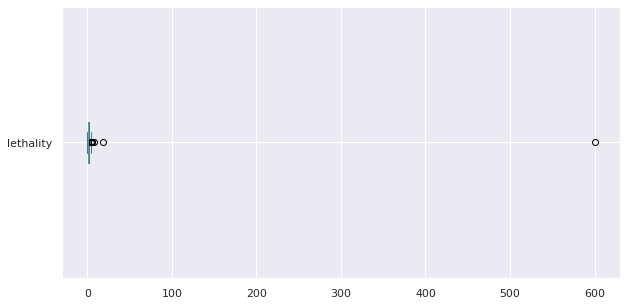

In [ ]:
# Plotando Boxplot para verificar se há outros outliers além do valor 600. Encontramos mais alguns, contudo, como 600 é o mais extremo irei eliminar apenas ele.
lethality_today.lethality.plot(kind='box', vert=False, figsize=(10,5))

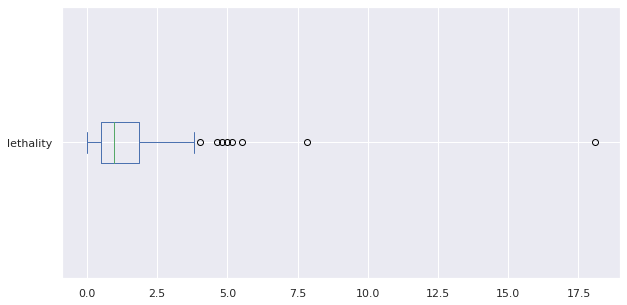

In [ ]:
# Podemos observar que alguns países podem realmente ter tido taxas de letalidade muito altas, contudo não é regra. Alguns dados podem ter coletas/divulgação distorcidas.
# Como nosso objetivo é apenas visualizar os dados do covid, irei deixar esses otliers para verificarmos a posição do Brasil em relação ao mundo.

lethality_today.lethality.loc[lethality_today.lethality < 600].plot(kind='box', vert=False, figsize=(10,5))

In [ ]:
# Reescrevendo a variável lethality_today para manter todas as taxas abaixo de 600
lethality_today = lethality_today.loc[lethality_today.lethality < 600]
lethality_today.lethality.describe()

count    226.000000
mean       1.332368
std        1.576033
min        0.015652
25%        0.493513
50%        0.955930
75%        1.845734
max       18.074508
Name: lethality, dtype: float64

### Barplot: Taxas Atuais dos Países

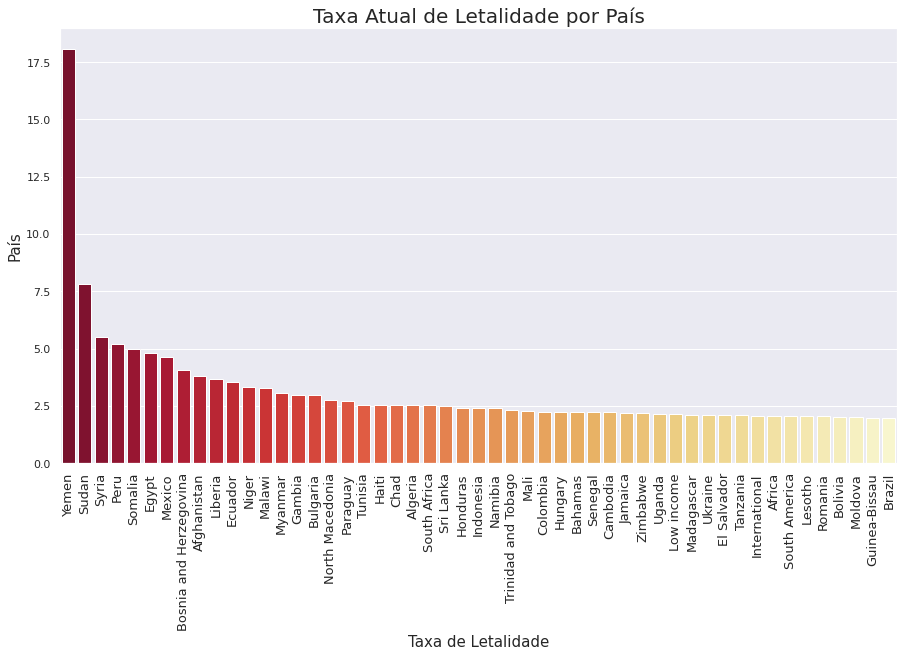

In [ ]:
# Podemos observar que das taxas de letalidades em relação aos demais países o Brasil está em 51º lugar.

sns.set_theme(style="darkgrid")

fig, ax = plt.subplots(figsize=(15,8))

sns.barplot(data=lethality_today.sort_values(by='lethality', ascending=False).head(51), x='location', y='lethality', palette='YlOrRd_r', orient='v', ax=ax)
ax.set_title('Taxa Atual de Letalidade por País', fontdict={'fontsize':20})
ax.set_ylabel('País', fontdict={'fontsize':15})
ax.set_xlabel('Taxa de Letalidade', fontdict={'fontsize':15})
ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontdict={'fontsize':13});

### Lineplot: Evolução da Taxa de Letalidade do Brasil vs Mundo

In [ ]:
# Criando o dataframe filtrando o Brasil e o Mundo

world_vs_brazil = df[df['location'].isin(['Brazil', 'World'])]
world_vs_brazil.head()


,iso_code,continent,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,...,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,population,excess_mortality_cumulative_absolute,excess_mortality_cumulative,excess_mortality,excess_mortality_cumulative_per_million,lethality
date,,,,,,,,,,,,,,,,,,,,,
2020-02-26,BRA,South America,Brazil,2020-02-26,1.0,1.0,NaN,NaN,NaN,NaN,...,NaN,2.2,75.88,0.765,215313504.0,NaN,NaN,NaN,NaN,NaN
2020-02-27,BRA,South America,Brazil,2020-02-27,1.0,0.0,NaN,NaN,NaN,NaN,...,NaN,2.2,75.88,0.765,215313504.0,NaN,NaN,NaN,NaN,NaN
2020-02-28,BRA,South America,Brazil,2020-02-28,1.0,0.0,NaN,NaN,NaN,NaN,...,NaN,2.2,75.88,0.765,215313504.0,NaN,NaN,NaN,NaN,NaN
2020-02-29,BRA,South America,Brazil,2020-02-29,2.0,1.0,NaN,NaN,NaN,NaN,...,NaN,2.2,75.88,0.765,215313504.0,2427.8,1.14,3.12,11.327592,NaN
2020-03-01,BRA,South America,Brazil,2020-03-01,2.0,0.0,NaN,NaN,NaN,NaN,...,NaN,2.2,75.88,0.765,215313504.0,NaN,NaN,NaN,NaN,NaN


In [ ]:
# Verificando se o filtro funcionou
world_vs_brazil.location.unique()

array(['Brazil', 'World'], dtype=object)

In [ ]:
# Criando Dataframe para evolução da taxa de letalidade
world_vs_brazil_lethality = world_vs_brazil.pivot(columns='location', values='lethality')

Text(0.5, 0, 'Período')

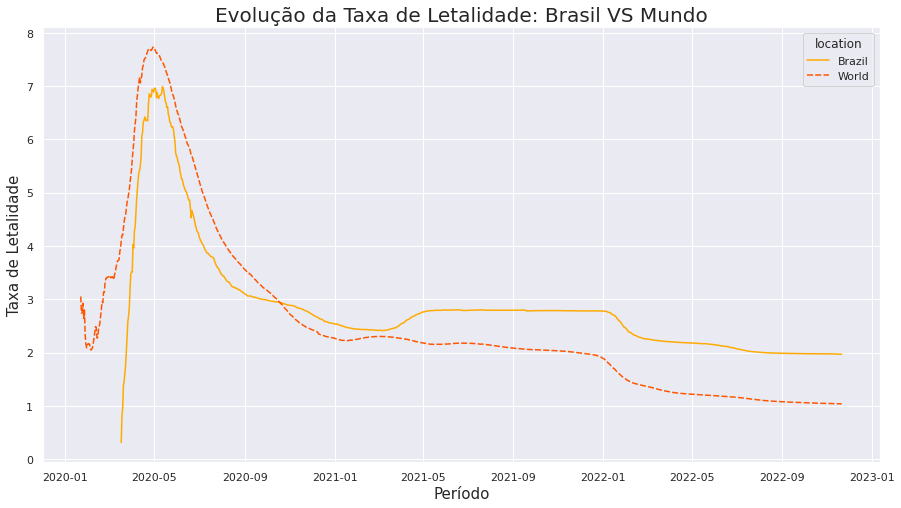

In [ ]:
# Gráfico de Linhas com evolução da taxa de letalidade

sns.set_theme(style="darkgrid")

fig, ax = plt.subplots(figsize=(15,8))

sns.lineplot(data=world_vs_brazil_lethality, palette='autumn_r', ax=ax)
ax.set_title('Evolução da Taxa de Letalidade: Brasil VS Mundo', fontdict={'fontsize':20})
ax.set_ylabel('Taxa de Letalidade', fontdict={'fontsize':15})
ax.set_xlabel('Período', fontdict={'fontsize':15})




In [ ]:
# Criando a coluna letalidade dentro do nosso dataframe do G20 recebendo seu indice.
dfG20['lethality'] = (dfG20.total_deaths / dfG20.total_cases)*100

In [ ]:
# Verificando se nossa coluna letalidade está no dataframe
dfG20.columns

Index(['iso_code', 'continent', 'location', 'date', 'total_cases', 'new_cases',
       'new_cases_smoothed', 'total_deaths', 'new_deaths',
       'new_deaths_smoothed', 'total_cases_per_million',
       'new_cases_per_million', 'new_cases_smoothed_per_million',
       'total_deaths_per_million', 'new_deaths_per_million',
       'new_deaths_smoothed_per_million', 'reproduction_rate', 'icu_patients',
       'icu_patients_per_million', 'hosp_patients',
       'hosp_patients_per_million', 'weekly_icu_admissions',
       'weekly_icu_admissions_per_million', 'weekly_hosp_admissions',
       'weekly_hosp_admissions_per_million', 'total_tests', 'new_tests',
       'total_tests_per_thousand', 'new_tests_per_thousand',
       'new_tests_smoothed', 'new_tests_smoothed_per_thousand',
       'positive_rate', 'tests_per_case', 'tests_units', 'total_vaccinations',
       'people_vaccinated', 'people_fully_vaccinated', 'total_boosters',
       'new_vaccinations', 'new_vaccinations_smoothed',
       't

In [ ]:
# Criando uma varíavel selecionando as datas mais recentes da taxa de letalidade
G20_lethality_today = dfG20.loc[dfG20.index.max()]
G20_lethality_today.head()

,iso_code,continent,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,...,hospital_beds_per_thousand,life_expectancy,human_development_index,population,excess_mortality_cumulative_absolute,excess_mortality_cumulative,excess_mortality,excess_mortality_cumulative_per_million,day,lethality
date,,,,,,,,,,,,,,,,,,,,,
2022-11-21,ARG,South America,Argentina,2022-11-21,9723924.0,NaN,NaN,130017.0,0.0,0.857,...,5.00,76.67,0.845,4.551032e+07,NaN,NaN,NaN,NaN,21,1.337084
2022-11-21,AUS,Oceania,Australia,2022-11-21,10564087.0,3807.0,10981.429,16007.0,27.0,18.000,...,3.84,83.44,0.944,2.617741e+07,NaN,NaN,NaN,NaN,21,0.151523
2022-11-21,BRA,South America,Brazil,2022-11-21,34999495.0,NaN,NaN,688907.0,NaN,NaN,...,2.20,75.88,0.765,2.153135e+08,NaN,NaN,NaN,NaN,21,1.968334
2022-11-21,CAN,North America,Canada,2022-11-21,4421434.0,1822.0,2506.143,47717.0,29.0,61.857,...,2.50,82.43,0.929,3.845433e+07,NaN,NaN,NaN,NaN,21,1.079220
2022-11-21,CHN,Asia,China,2022-11-21,1319652.0,27596.0,26115.143,5231.0,2.0,0.714,...,4.34,76.91,0.761,1.425887e+09,NaN,NaN,NaN,NaN,21,0.396392


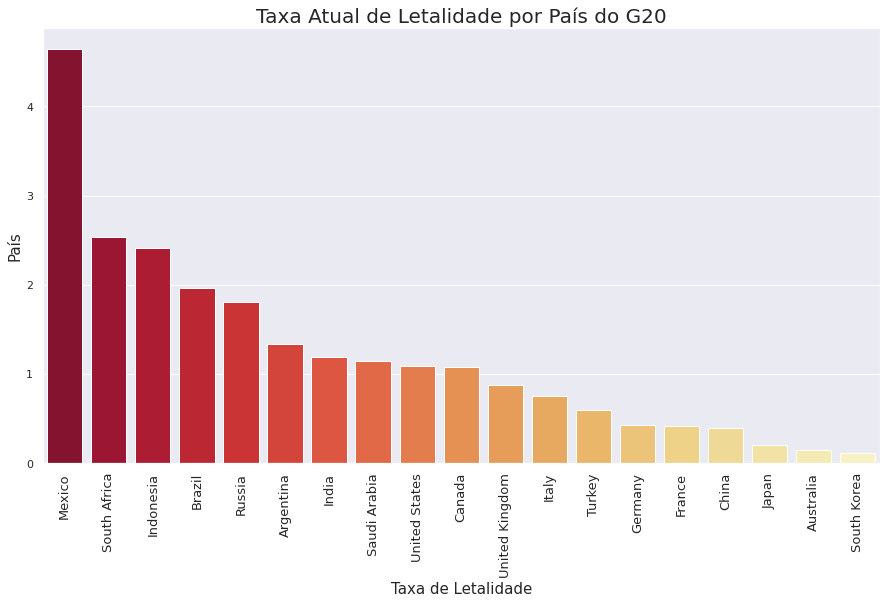

In [ ]:
# Criando um gráfico de barras filtrando a data máxima do meu Dataframe (data mais recente) e capturando a taxa de lethalidade dos países do G20
sns.set_theme(style="darkgrid")

fig, ax = plt.subplots(figsize=(15,8))

sns.barplot(data=G20_lethality_today.sort_values(by='lethality', ascending=False).head(51), x='location', y='lethality', palette='YlOrRd_r', orient='v', ax=ax)
ax.set_title('Taxa Atual de Letalidade por País do G20', fontdict={'fontsize':20})
ax.set_ylabel('País', fontdict={'fontsize':15})
ax.set_xlabel('Taxa de Letalidade', fontdict={'fontsize':15})
ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontdict={'fontsize':13});

### Scatterplot: Correlação entre o PIB dos Países e a Taxa de Letalidade

Não há uma correlação entre as variáveis como podemos observar. Muitos países com PIB baixo estão com taxas de letalidade baixas.

Text(0.5, 0, 'Taxa de Letalidade')

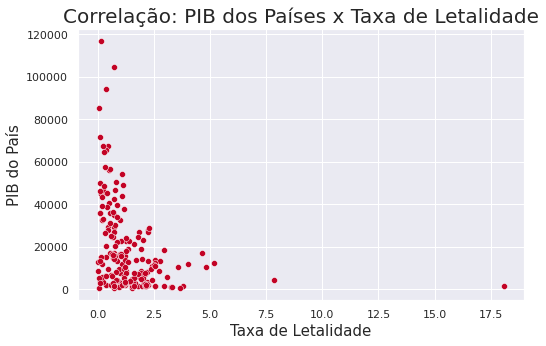

In [ ]:
sns.set_theme(style="darkgrid", palette='YlOrRd_r')

fig, ax = plt.subplots(figsize=(8,5))

sns.scatterplot(data=lethality_today, x='lethality', y='gdp_per_capita', ax=ax)
ax.set_title('Correlação: PIB dos Países x Taxa de Letalidade', fontdict={'fontsize':20})
ax.set_ylabel('PIB do País', fontdict={'fontsize':15})
ax.set_xlabel('Taxa de Letalidade', fontdict={'fontsize':15})

## Conclusão

Podemos observar que, mesmo hoje em dia com o avanço da tecnolgia e do conhecimento. Não existem padrões para os danos que uma nova doença pode causar. Observamos paises desenvolvidos e menos desenvolvidos apresentando números altos de contágio e mortes. 

Diante do cenário geral o Brazil apresentou uma taxa de mortalidade menor que diversos países ficando na 51ª posição, contudo, quando filtramos pelo G20, observamos que nossa taxa esteve entre nos mais altos, ficando na 4ª posição.

Na colula 'location' observamos que existe um cumulativo que os dados do mundo todo chamada 'World'. Ao plotar a evolução da taxa de letalidade, com essa métrica obtemos automaticamente a taxa média do mundo todo e comparando a evolução do Brasil, vimos que se desprendeu dessa média cerca de 1 ppt desde maio de 2021. Vimos que 

